# Import des librairies et des fichiers

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import datetime as dt

from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans

import folium
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#from google.colab import files

In [ ]:
#uploaded = files.upload()

In [ ]:
dt_apr14 = pd.read_csv("https://raw.githubusercontent.com/fivethirtyeight/uber-tlc-foil-response/master/uber-trip-data/uber-raw-data-apr14.csv")
dataset = dt_apr14
dataset.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


# Preprocessing

### Travail sur la variable de temps ("Date/Time")

In [ ]:
dataset['Date/Time'] =  pd.to_datetime(dataset['Date/Time'])

In [ ]:
dataset['num_day'] = dataset['Date/Time'].dt.dayofweek
dataset['name_day'] = dataset['Date/Time'].dt.weekday
dataset['day'] = dataset['Date/Time'].dt.day
dataset['hour'] = dataset['Date/Time'].dt.hour
dataset['minute'] = dataset['Date/Time'].dt.minute

In [ ]:
dataset.head()

,Date/Time,Lat,Lon,Base,num_day,name_day,day,hour,minute
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1,1,1,0,11
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1,1,1,0,17
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1,1,1,0,21
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1,1,1,0,28
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1,1,1,0,33


# Visualisations

## Répartition des variables Hour/Day

Distribution des **heures de Pickups** : 4 tendeances se dessinnent : 

- 6 AM / 11 AM 
- 12 PM / 5 PM
- 6 PM / 11 PM
- 12 AM / 5 AM

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


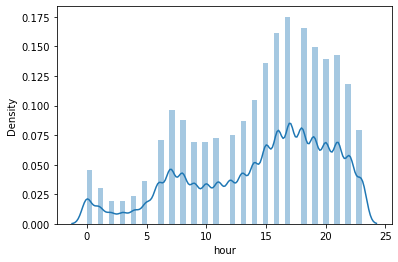

In [ ]:
sns.distplot(dataset.hour)

Le **mercredi** semble une journée particulièrement chargée

/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


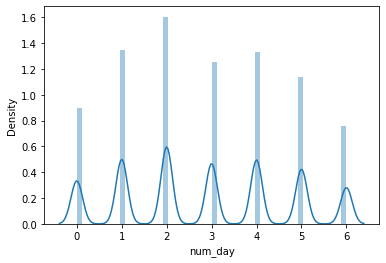

In [ ]:
sns.distplot(dataset.num_day)

## Heatmap des Pickups sur NYC

### Heatmap de l'ensemble du mois

In [ ]:
def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map
  
from folium.plugins import HeatMap
dataset['count'] = 1
base_map = generateBaseMap()
HeatMap(data=dataset[['Lat', 'Lon', 'count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist(), radius=8, gradient={0.2: 'blue', 0.6: 'lime', 0.8: 'orange', 1: 'red'},min_opacity=0.1, max_zoom=13).add_to(base_map)
base_map

## Evolution des Pickups selon l'heure du jour ou de la nuit 

In [ ]:
df_hour_list = []
for hour in dataset.hour.sort_values().unique():
    df_hour_list.append(dataset.loc[dataset.hour == hour, ['Lat', 'Lon','count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist())

In [ ]:
base_map_time = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map_time)
base_map_time

# Entraînement d'un modèle K-Means

Détermination du X autour des variables "Lat" et "Lon"

In [ ]:
X = dataset[['Lat', 'Lon']]

### Méthode Elbow pour déterminer le nombre optimum de clusters

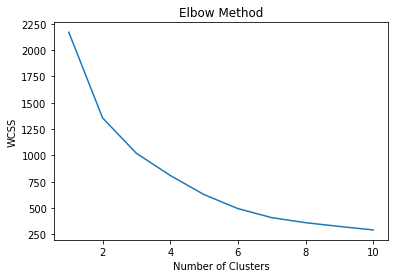

In [ ]:
from sklearn.cluster import KMeans
wcss =  []
for i in range (1,11): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", max_iter = 300, n_init = 10, random_state = 0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
plt.plot(range(1,11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

### Affinement au moyen des Silhouettes

Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.5745566973301872
For n_clusters = 6 The average silhouette_score is : 0.43902711183132426


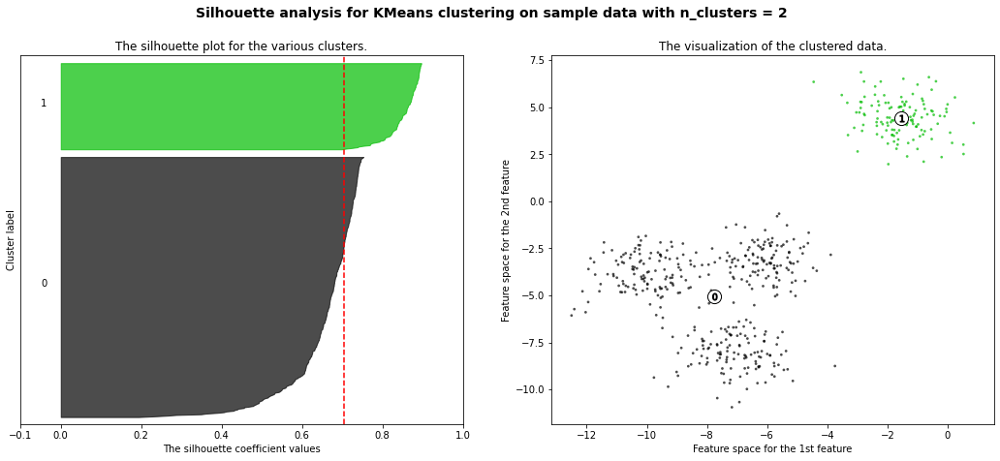

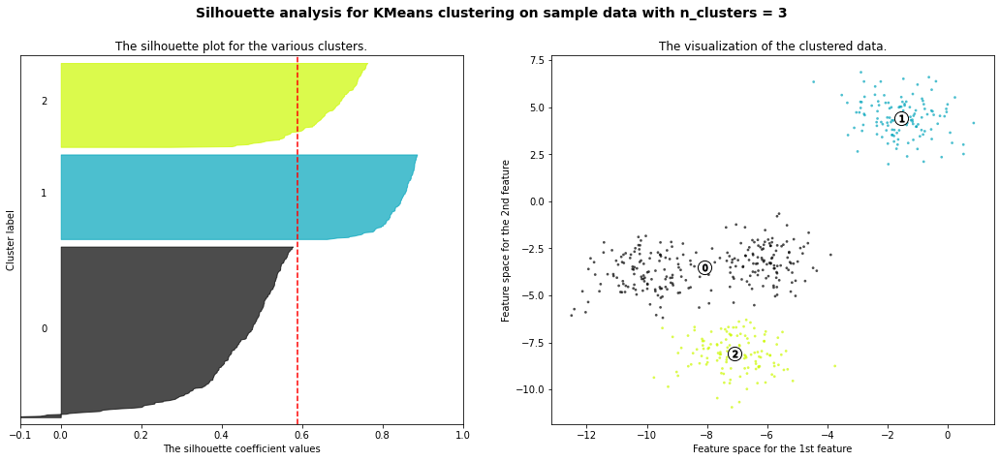

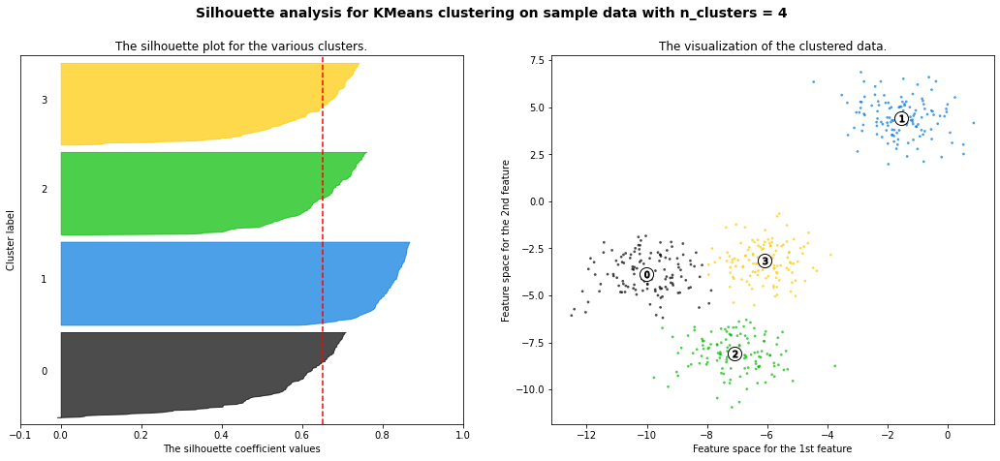

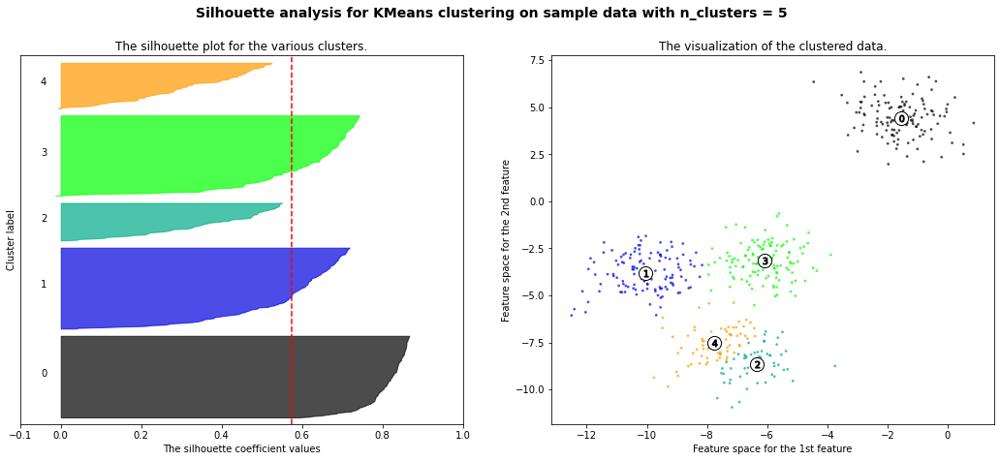

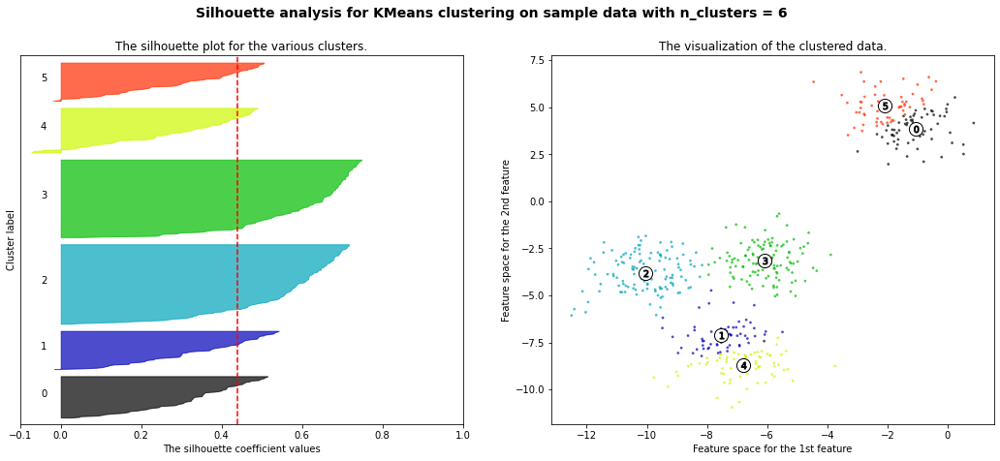

In [ ]:
print(__doc__)

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.
X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  cluster_std=1,
                  center_box=(-10.0, 10.0),
                  shuffle=True,
                  random_state=1)  # For reproducibility

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

### Le nombre de clusters idéal semble être à 4, c'est ainsi que le K-Means sera entraîné

Entraînement du modèle avec 4 clusters

In [ ]:
X = dataset[['Lat', 'Lon']]
kmeans = KMeans(n_clusters= 4, init= "k-means++", max_iter=300, n_init = 10, random_state=0)
kmean = kmeans.fit(X)

Centroids placés dans la liste "centroids_list"

In [ ]:
centroids = kmean.cluster_centers_
centroids_tuples = tuple(map(tuple, centroids))
centroids_list = list(centroids_tuples)


In [ ]:
centroids_list

[(40.72141267879186, -73.9923696412024),
 (40.717129328004, -73.81298045394526),
 (40.76622268658464, -73.97242426405107),
 (40.70046739979445, -74.2014989311408)]

### Heatmap de l'ensemble du mois avec les centroids

In [ ]:
dataset['count'] = 1
base_map_k = generateBaseMap()
HeatMap(data=dataset[['Lat', 'Lon', 'count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist(), radius=8, min_opacity=0.1,max_zoom=13).add_to(base_map_k)

for coord in centroids_list:
  folium.CircleMarker(location=([ coord[0], coord[1] ]), radius=10,color='darkblue',fill_color='darkblue').add_to(base_map_k)

In [ ]:
base_map_k

### Evolution des Pickups selon l'heure du jour ou de la nuit avec les centroids

In [ ]:
df_hour_list

In [ ]:
df_hour_list = []
for hour in dataset.hour.sort_values().unique():
    df_hour_list.append(dataset.loc[dataset.hour == hour, ['Lat', 'Lon','count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist())

from folium.plugins import HeatMapWithTime
base_map_time_k = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map_time_k)

for coord in centroids_list:
  folium.CircleMarker(location=([ coord[0], coord[1] ]), radius=10,color='darkblue',fill_color='darkblue').add_to(base_map_time_k)


In [ ]:
base_map_time_k

In [ ]:
dataset.head()

,Date/Time,Lat,Lon,Base,num_day,name_day,day,hour,minute,count
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,1,Tuesday,1,0,11,1
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,1,Tuesday,1,0,17,1
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,1,Tuesday,1,0,21,1
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,1,Tuesday,1,0,28,1
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,1,Tuesday,1,0,33,1


# Entraînement d'un modèle DBSCAN

### Définition des paramètres pour le DBSCAN

Restriction du dataset afin de faciliter l'apprentissage du modèle : 

- La visualisation a montré que **le jour avec le plus de Pickups est le mercredi**
- **L'heure avec le plus de Pickups est le créneau 5 PM**

In [ ]:
dataset[(dataset.num_day == 2) & (dataset.hour == 17)].count()

Date/Time    9151
Lat          9151
Lon          9151
Base         9151
num_day      9151
name_day     9151
day          9151
hour         9151
minute       9151
count        9151
dtype: int64

Création du **dataset réduit** avec le profil "meilleure_course" (Mercredi / 5 PM)

In [ ]:
meilleure_course = dataset.loc[(dataset['num_day']== 2) & (dataset['hour'] == 17)]
meilleure_course = meilleure_course.iloc[:,1:3]

Mise en place des **paramètres pour le DBSCAN** :
- max_distance : 5 mètres entre chaque Pickup
- min_pickups : 5 courses minimum afin de constituer un point

In [ ]:
max_distance = 0.005
min_pickups = 5

Instanciation du DBSCAN

In [ ]:
from sklearn.cluster import DBSCAN
dbsc = DBSCAN(eps = max_distance, min_samples = min_pickups).fit(meilleure_course)

In [ ]:
dbsc_predict = dbsc.fit_predict(meilleure_course)
coord_dbsc = dbsc.components_

### Affichage des clusters du DBSCAN

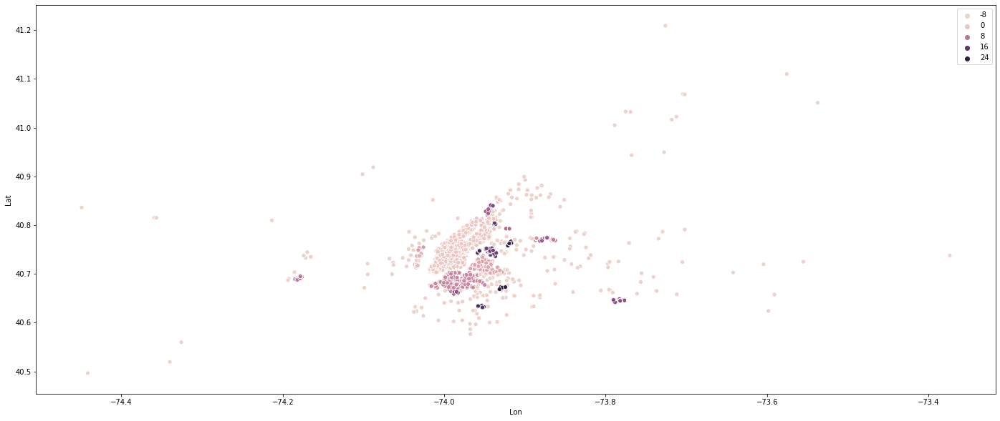

In [ ]:
plt.figure(figsize=(24, 10))
sns.scatterplot(meilleure_course.iloc[:,1], meilleure_course.iloc[:, 0],hue = dbsc_predict)